In [1]:
from __future__ import division, print_function, absolute_import
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import pickle

import plotly as py
import plotly.graph_objects as go

import random

from sklearn import preprocessing
from sklearn.model_selection import train_test_split, KFold, cross_val_score, cross_val_predict, cross_validate
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from scipy.stats import hmean
import xgboost as xgb
from sklearn.dummy import DummyRegressor
from sklearn.metrics import precision_recall_curve, confusion_matrix, accuracy_score, roc_auc_score, f1_score, precision_score, recall_score, average_precision_score 
import re

import seaborn as sns

In [2]:
# Sequences containing C = 2740
# Sequences Containing PXXX or C = 6846

#load dataset
df20 = pd.read_csv('../DataFiles/df20.csv', index_col=0, engine='c')
dfvz = pd.read_csv("../DataFiles/FullDataSet.csv", engine='c')
#correcting  vhse.4 value for N from -0.69 to +0.69 uniformly
dfvz.loc[dfvz['vhse1.4'] == -0.69,'vhse1.4'] = 0.69
dfvz.loc[dfvz['vhse2.4'] == -0.69,'vhse2.4'] = 0.69
dfvz.loc[dfvz['vhse3.4'] == -0.69,'vhse3.4'] = 0.69
dfvz.loc[dfvz['vhse4.4'] == -0.69,'vhse4.4'] = 0.69

# Patter is to filter out PXXX, not PPXX, and X=C
patternDel ="(^P[^P])|([C])"
filter = dfvz['seq'].str.contains(patternDel)
dfPX = dfvz[filter]
dfNPX = dfvz[~filter]

idxPX = dfPX.index.to_list()
idxNPX = dfNPX.index.to_list()

Index(['..AA', '..AR', '..AN', '..AD', '..AC', '..AE', '..AQ', '..AG', '..AH',
       '..AI',
       ...
       'M...', 'F...', 'P...', 'S...', 'T...', 'W...', 'Y...', 'V...', 'seq',
       'label'],
      dtype='object', length=2398)
Index(['seq', 'label', 'log.label', 'z1.1', 'z1.2', 'z1.3', 'z2.1', 'z2.2',
       'z2.3', 'z3.1', 'z3.2', 'z3.3', 'z4.1', 'z4.2', 'z4.3',
       'z3.linear.pred', 'z3.svm.pred', 'z3.tree.pred', 'z3.knn.pred',
       'vhse1.1', 'vhse1.2', 'vhse1.3', 'vhse1.4', 'vhse1.5', 'vhse1.6',
       'vhse1.7', 'vhse1.8', 'vhse2.1', 'vhse2.2', 'vhse2.3', 'vhse2.4',
       'vhse2.5', 'vhse2.6', 'vhse2.7', 'vhse2.8', 'vhse3.1', 'vhse3.2',
       'vhse3.3', 'vhse3.4', 'vhse3.5', 'vhse3.6', 'vhse3.7', 'vhse3.8',
       'vhse4.1', 'vhse4.2', 'vhse4.3', 'vhse4.4', 'vhse4.5', 'vhse4.6',
       'vhse4.7', 'vhse4.8', 'vhse.linear.pred', 'vhse.svm.pred',
       'vhse.tree.pred', 'vhse.knn.pred'],
      dtype='object')


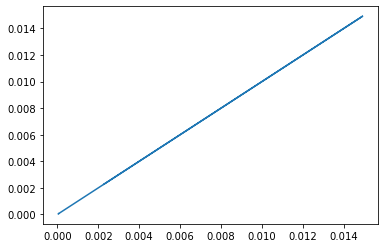

In [3]:
#sanity checks
print(df20.iloc[:,:].columns)
print(dfvz.iloc[:,:].columns)
print(plt.plot(dfvz['label'], df20['label']))

In [4]:
#Define X and y
stdscalar = preprocessing.StandardScaler()

Xp = df20.loc[:,'..AA':'V...'].values #sequence pattern descriptors #(67278, 2396)
Xp_names = df20.loc[:,'..AA':'V...'].columns
stdscalar.fit(Xp[idxNPX])
Xp_s= stdscalar.transform(Xp)

Xz=dfvz.loc[:,'z1.1':'z4.3'].values #zscale descriptors #(67278, 12)
Xz_names = dfvz.loc[:,'z1.1':'z4.3'].columns
stdscalar.fit(Xz[idxNPX])
Xz_s= stdscalar.transform(Xz)

Xv=dfvz.loc[:,'vhse1.1':'vhse4.8'].values #vhse descriptors #(67278, 32)
Xv_names = dfvz.loc[:,'vhse1.1':'vhse4.8'].columns
stdscalar.fit(Xv[idxNPX])
Xv_s= stdscalar.transform(Xv)

Xvz_names = list(Xz_names)+list(Xv_names) #zscale and vhse combined #(67278, 44)
Xvz=dfvz.loc[:,Xvz_names].values
stdscalar.fit(Xvz[idxNPX])
Xvz_s= stdscalar.transform(Xvz)

Xpvz_names = list(Xvz_names)+list(Xp_names)#pattern and zscale, vhse combined #(67278, 2440)
Xpvz=pd.concat([dfvz.loc[:,Xvz_names],df20.loc[:,list(Xp_names)]],axis=1).values
stdscalar.fit(Xpvz[idxNPX])
Xpvz_s= stdscalar.transform(Xpvz)

y = dfvz['log.label'].values.reshape(-1,1)

In [5]:
#create dictionary to maintainence 

keys = ['Xp','Xp_s','Xz','Xz_s','Xv','Xv_s','Xvz','Xvz_s','Xpvz','Xpvz_s']
vals = [Xp,Xp_s,Xz,Xz_s,Xv,Xv_s,Xvz,Xvz_s,Xpvz,Xpvz_s]
name_vals = [Xp_names,Xp_names,Xz_names,Xz_names,Xv_names,Xv_names,Xvz_names,Xvz_names,Xpvz_names,Xpvz_names]

'''
#with PCA features
keys = ['Xp','Xp_s','Xp_sp','Xz','Xz_s','Xz_sp','Xv','Xv_s','Xv_sp','Xvz','Xvz_s','Xvz_sp','Xpvz','Xpvz_s','Xpvz_sp']
vals = [Xp,Xp_s,Xp_s,Xz,Xz_s,Xz_sp,Xv,Xv_s,Xv_sp,Xvz,Xvz_s,Xvz_sp,Xpvz,Xpvz_s,Xpvz_sp]
name_vals = [Xp_names,Xp_names,Xp_names,Xz_names,Xz_names,Xz_names,
             Xv_names,Xv_names,Xv_names,Xvz_names,Xvz_names,Xvz_names,
             Xpvz_names,Xpvz_names,Xpvz_names]
'''

X_dict = dict(zip(keys, vals))
Xname_dict = dict(zip(keys, name_vals))

ykey = ['real']
yval = [y]
y_dict = dict(zip(ykey, yval))

In [6]:
# Separate out training data so no pp slips through!
X = X_dict['Xpvz'][idxNPX]
# X_pp = X_dict['Xpvz'][idxPX]
X_colnames = Xpvz_names
y = y_dict['real'][idxNPX]
# y_pp = y_dict['high'][idxPX]

In [45]:
y_bottom_500 = y[np.argpartition(y.ravel(), 500)[:500]]

In [46]:
X_bottom_500 = X[np.argpartition(y.ravel(), 500)[:500]]

In [47]:
y_top_500 = y[np.argpartition(y.ravel(), -500)[-500:]]

In [48]:
X_top_500 = X[np.argpartition(y.ravel(), -500)[-500:]]

In [9]:
# Details about the current data and its range:
print(f'Y - Value: LogDC \
    \nMax Y Value: {np.max(y)} \nMin Y Value: {np.min(y)} \
    \nAverage Y Value: {np.average(y)} \
    \nLength of Y: {len(y)} \
    \nShape of X: {X.shape}')

Y - Value: LogDC     
Max Y Value: -1.8261880000000001 
Min Y Value: -4.439897     
Average Y Value: -2.7528466023779985     
Length of Y: 60432     
Shape of X: (60432, 2440)


## Model Testing

1. Run XGB Model in SK Fold
2. Run Dummy Regressor 
3. Compare Stats

In [14]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.1, random_state=42)

X_train, X_validate, y_train, y_validate = train_test_split(
    X_train, y_train, test_size=0.1, random_state=42
)

params = {'n_estimators': 500,
          'learning_rate': 0.01,
          'objective':'reg:squarederror',                                   
          'n_jobs':-1,
          'verbosity':1,
          'tree_method':'gpu_hist'
          }

In [12]:
reg = xgb.XGBRegressor(**params)
reg.fit(X_train, y_train, early_stopping_rounds=25, eval_set=[(X_validate, y_validate)])

y_pred = reg.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mas = mean_absolute_error(y_test, y_pred)
print("The root mean squared error (MSE) on test set: {:.4f}".format(rmse))
print("The mean absolute error (MAS) on test set: {:.4f}".format(mas))

[0]	validation_0-rmse:3.23708
Will train until validation_0-rmse hasn't improved in 25 rounds.
[1]	validation_0-rmse:3.20498
[2]	validation_0-rmse:3.17321
[3]	validation_0-rmse:3.14175
[4]	validation_0-rmse:3.11062
[5]	validation_0-rmse:3.07979
[6]	validation_0-rmse:3.04928
[7]	validation_0-rmse:3.01908
[8]	validation_0-rmse:2.98918
[9]	validation_0-rmse:2.95958
[10]	validation_0-rmse:2.93029
[11]	validation_0-rmse:2.90128
[12]	validation_0-rmse:2.87257
[13]	validation_0-rmse:2.84415
[14]	validation_0-rmse:2.81601
[15]	validation_0-rmse:2.78816
[16]	validation_0-rmse:2.76059
[17]	validation_0-rmse:2.73329
[18]	validation_0-rmse:2.70628
[19]	validation_0-rmse:2.67954
[20]	validation_0-rmse:2.65305
[21]	validation_0-rmse:2.62683
[22]	validation_0-rmse:2.60090
[23]	validation_0-rmse:2.57521
[24]	validation_0-rmse:2.54979
[25]	validation_0-rmse:2.52461
[26]	validation_0-rmse:2.49969
[27]	validation_0-rmse:2.47503
[28]	validation_0-rmse:2.45063
[29]	validation_0-rmse:2.42646
[30]	validation

In [15]:
#average cross validated f1 5 fold with grid search optimized hyperparameters
# For High DC
skf5 = KFold(n_splits=5, shuffle = True, random_state=42)
mod_high = xgb.XGBRegressor(
    **params
) 

mae_dict = {}
rmse_dict = {}

i = 0

for train_index, test_index in skf5.split(X, y):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]
    i = i + 1
    
    print ('Fold #: ' + str(i))
    mod_high.fit(X_train, y_train, early_stopping_rounds=25, eval_set=[(X_test, y_test)])

    y_pred = mod_high.predict(X_test)

    mae_dict[i] = mean_absolute_error(y_test, y_pred)
    rmse_dict[i] = np.sqrt(mean_squared_error(y_test, y_pred))

    print("MAE score: {0:,.2f}".format(mae_dict[i]))
    print("RMSE score: {0:,.2f}".format(rmse_dict[i]))  


[376]	validation_0-rmse:0.29180
[377]	validation_0-rmse:0.29160
[378]	validation_0-rmse:0.29141
[379]	validation_0-rmse:0.29122
[380]	validation_0-rmse:0.29103
[381]	validation_0-rmse:0.29085
[382]	validation_0-rmse:0.29067
[383]	validation_0-rmse:0.29050
[384]	validation_0-rmse:0.29032
[385]	validation_0-rmse:0.29015
[386]	validation_0-rmse:0.28998
[387]	validation_0-rmse:0.28981
[388]	validation_0-rmse:0.28965
[389]	validation_0-rmse:0.28950
[390]	validation_0-rmse:0.28934
[391]	validation_0-rmse:0.28919
[392]	validation_0-rmse:0.28904
[393]	validation_0-rmse:0.28888
[394]	validation_0-rmse:0.28874
[395]	validation_0-rmse:0.28860
[396]	validation_0-rmse:0.28846
[397]	validation_0-rmse:0.28832
[398]	validation_0-rmse:0.28819
[399]	validation_0-rmse:0.28806
[400]	validation_0-rmse:0.28792
[401]	validation_0-rmse:0.28779
[402]	validation_0-rmse:0.28766
[403]	validation_0-rmse:0.28755
[404]	validation_0-rmse:0.28743
[405]	validation_0-rmse:0.28731
[406]	validation_0-rmse:0.28720
[407]	v

In [16]:
for dt in [mae_dict, rmse_dict]:
    print(np.mean(list(dt.values())))
    print(np.std(list(dt.values())))

0.17619028175251153
0.0011025589698332877
0.27643299535832044
0.003647188748247587


In [17]:
y_test_1 = np.array([x[0] for x in y_test])

In [27]:
pairs = list(zip(y_pred, y_test_1))
pairs = random.sample(pairs, 100)
y_pred_sampled, y_test_1_sampled = zip(*pairs)

In [28]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=y_pred_sampled, y=y_test_1_sampled,
    mode='markers',
))

In [29]:
# Train Model on All Data & Save Model As Is:
mod_regressor = xgb.XGBRegressor(
    **params
) 

mod_regressor.fit(X, y)

y_pred = mod_regressor.predict(X)


#save model to file
pickle.dump(mod_regressor, open("../03_Saved_Models/final_npx_mod_regr_xgb_cor.pickle", "wb"))

In [50]:
mod_regressor  = pickle.load(open("../03_Saved_Models/final_npx_mod_regr_xgb_cor.pickle", "rb"))

In [52]:
top_500_pred = mod_regressor.predict(X_top_500)
bot_500_pred = mod_regressor.predict(X_bottom_500)

print(f'RMSE - Top 500: {np.sqrt(mean_squared_error(y_top_500, top_500_pred))}\
    \nRMSE - Bottom 500: {np.sqrt(mean_squared_error(y_bottom_500, bot_500_pred))}')

RMSE - Top 500: 0.4320235084173954    
RMSE - Bottom 500: 1.5303647228968804


In [55]:
y.max()-y.min()

2.613709

In [ ]:
print()

In [30]:
mae_dict = mean_absolute_error(y, y_pred)
rmse_dict = np.sqrt(mean_squared_error(y, y_pred))

print("MAE score: {0:,.4f}".format(mae_dict))
print("RMSE score: {0:,.4f}".format(rmse_dict))  

MAE score: 0.1720
RMSE score: 0.2671


In [32]:
dummy = DummyRegressor(strategy='median')
dummy.fit(X, y)

dumm_pred = dummy.predict(X)

mae_dict = mean_absolute_error(y, dumm_pred)
rmse_dict = np.sqrt(mean_squared_error(y, dumm_pred))

print("MAE score: {0:,.2f}".format(mae_dict))
print("RMSE score: {0:,.2f}".format(rmse_dict))  

MAE score: 0.21
RMSE score: 0.31


In [24]:
#average cross validated f1 5 fold with grid search optimized hyperparameters
# For High DC
skf5 = KFold(n_splits=5, shuffle = True, random_state=42)
mod_dummy = DummyRegressor(
    strategy='mean'
) 

mae_dict = {}
rmse_dict = {}

i = 0

for train_index, test_index in skf5.split(X, y):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]
    i = i + 1
    
    print ('Fold #: ' + str(i))
    mod_dummy.fit(X_train, y_train)

    y_pred = mod_dummy.predict(X_test)

    mae_dict[i] = mean_absolute_error(y_test, y_pred)
    rmse_dict[i] = np.sqrt(mean_squared_error(y_test, y_pred))

    print("MAE score - Dummy: {0:,.2f}".format(mae_dict[i]))
    print("RMSE score - Dummy: {0:,.2f}".format(rmse_dict[i]))  

Fold #: 1
MAE score - Dummy: 0.22
RMSE score - Dummy: 0.32
Fold #: 2
MAE score - Dummy: 0.22
RMSE score - Dummy: 0.32
Fold #: 3
MAE score - Dummy: 0.22
RMSE score - Dummy: 0.31
Fold #: 4
MAE score - Dummy: 0.22
RMSE score - Dummy: 0.32
Fold #: 5
MAE score - Dummy: 0.22
RMSE score - Dummy: 0.32


In [25]:
for dt in [mae_dict, rmse_dict]:
    print(np.mean(list(dt.values())))
    print(np.std(list(dt.values())))

0.2171428534742422
0.0008675137150365537
0.3180902696085919
0.0029244196341600306


In [87]:
#this function creates features for a given query sequence
def feat_extractor(seqs, ft_dict):
    #seqs: array of sequences to extract features from
    #ft_dict: feature extraction dict
    
    ext_feat = dict()
    for seq_ex in tqdm_notebook(seqs):

        ext_feat[seq_ex] = dict()
        for pos,b in enumerate(seq_ex):
            for featn in range(8):
                ext_feat[seq_ex]['vhse'+str(pos+1)+'.'+str(featn+1)] = ft_dict['vhse'][featn+1][b]
            for featn in range(3):
                ext_feat[seq_ex]['z'+str(pos+1)+'.'+str(featn+1)] = ft_dict['z'][featn+1][b]

        for pat in feat_extdict['pat_feat20']:
            ext_feat[seq_ex][pat] = int(pd.notnull(re.search(pat,seq_ex)))
    
    featext_df = pd.DataFrame(ext_feat).T
    return(featext_df.loc[:,ft_dict['Xpvz_names']])

###code for creating 20x20 plot
#function to locate index position of seq in 20x20 plot
def ttlocate(seqx):
    aa = ['R','K','Q','E','D','N','Y','P','T','S','H','A','G','W','M','F','L','V','I',]
    row_i1 = aa.index(seqx[0])
    row_i2 = aa.index(seqx[2])
    col_i1 = aa.index(seqx[1])
    col_i2 = aa.index(seqx[3])
    row_i = (row_i1*19) + row_i2
    col_i = (col_i1*19) + col_i2
    return (row_i,col_i)

#function to get 20x20 matrix given array of aa sequences and DC label
def ttmatrix(seqs,dc):
    #define empty matrix to fill in
    ttmat = np.zeros((361,361))
    for i,s in enumerate(seqs):
        #ttmat[ttlocate(s)[0],ttlocate(s)[1]] = dc[i]
        ttmat[ttlocate(s)] = dc[i]
    return ttmat   


#plot the ttmatrix, and highlight the query if present
def ttplot(seqs,dc,query = []):
    ttmat = ttmatrix(seqs,dc)

    aa = ['R','K','Q','E','D','N','Y','P','T','S','H','A','G','W','M','F','L','V','I',]
    ticks = [[a[0]] + ['']*18 for a in aa]
    ticks = [j for i in ticks for j in i]

    sns.set(rc={'figure.figsize':(9,6)})
    
    #if dc values are binary then use simple color map
    cm = 'Blues' if len(np.unique(dc)) ==2 else 'coolwarm'        
    ax = sns.heatmap(ttmat, cmap=cm,xticklabels=ticks, yticklabels=ticks)
    ax.set_title('Position of queried sequence/s in 19x19 plot (log (deep conversion))')
    if len(query)>0:
        for q in query:
            query_pos = ttlocate(q)[1], ttlocate(q)[0]
            ax.add_patch(Rectangle(query_pos, 1, 1, fill=True,edgecolor='yellow', lw=8))
    
    return ax.figure

In [68]:
feats = pickle.load(open("feature_160k.pickle", "rb"))

In [69]:
# Removes all sequences with C
filter = feats.index.str.contains('C')
feats = feats[~filter]

In [70]:
pred_df = pd.DataFrame(index=feats.index)

In [71]:
reg_val = mod_regressor.predict(feats.values)

In [72]:
pred_df['reg_val'] = reg_val

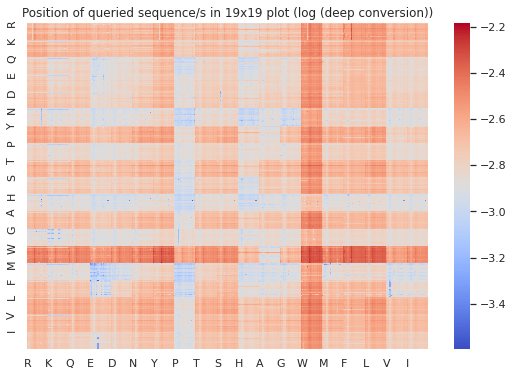

In [89]:
base_plot = ttplot(pred_df.index, pred_df.reg_val)

In [91]:
base_plot.tight_layout()
base_plot.savefig('20x20Regression_Plot_NoC.png', format='png')

In [78]:
pred_df.to_csv('predictions_regressor_GESAR-dec4.csv')

In [79]:
dfvz.set_index('seq', inplace=True)

In [80]:
pred_df_new = pred_df[~pred_df.index.isin(dfvz.index)]
pred_df_new[]

In [88]:
pred_df_new

,reg_val
RRRR,-2.646076
RRRK,-2.701735
RRRQ,-2.698288
RRRE,-2.712751
RRRD,-2.686730
...,...
IIIW,-2.837660
IIIM,-2.774962
IIIF,-2.776693
IIIL,-2.752500


In [82]:
pred_df_new.to_csv('pred_non_original_regressor_GESAR-Dec4.csv')